I can make this simpler by doing a radial profile rather than full 2D. Of course, this assumes symmetric PSF
TO do this I need:
1. Euclidean distance
2. Euclidean distance as an index

In [1]:
from astropy.io import ascii, fits
import pylab as plt
%matplotlib inline
from astropy import wcs


import numpy as np
import xidplus
from xidplus import moc_routines
import pickle

/usr/local/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


In [2]:
#Folder containing maps
imfolder='/Users/pdh21/astrodata/COSMOS/'

pswfits=imfolder+'COSMOS_image_250_SMAP_v4.1.fits'#SPIRE 250 map
pmwfits=imfolder+'COSMOS_image_350_SMAP_v4.1.fits'#SPIRE 350 map
plwfits=imfolder+'COSMOS_image_500_SMAP_v4.1.fits'#SPIRE 500 map


#Folder containing prior input catalogue
catfolder='/Users/pdh21/astrodata/COSMOS/P3/'
#prior catalogue
prior_cat='WP5_COSMOS_XID+SPIRE_20160815.fits'


#output folder
output_folder='./'

In [3]:
#-----250-------------
hdulist = fits.open(pswfits)
im250phdu=hdulist[0].header
im250hdu=hdulist[1].header

im250=hdulist[1].data*1.0E3
nim250=hdulist[2].data*1.0E3
w_250 = wcs.WCS(hdulist[1].header)
pixsize250=3600.0*w_250.wcs.cd[1,1] #pixel size (in arcseconds)
hdulist.close()
#-----350-------------
hdulist = fits.open(pmwfits)
im350phdu=hdulist[0].header
im350hdu=hdulist[1].header

im350=hdulist[1].data*1.0E3
nim350=hdulist[2].data*1.0E3
w_350 = wcs.WCS(hdulist[1].header)
pixsize350=3600.0*w_350.wcs.cd[1,1] #pixel size (in arcseconds)
hdulist.close()
#-----500-------------
hdulist = fits.open(plwfits)
im500phdu=hdulist[0].header
im500hdu=hdulist[1].header
im500=hdulist[1].data*1.0E3
nim500=hdulist[2].data*1.0E3
w_500 = wcs.WCS(hdulist[1].header)
pixsize500=3600.0*w_500.wcs.cd[1,1] #pixel size (in arcseconds)
hdulist.close()

In [4]:
hdulist = fits.open(catfolder+prior_cat)
fcat=hdulist[1].data
hdulist.close()
inra=fcat['RA']
indec=fcat['Dec']


In [5]:
#---prior250--------
prior250=xidplus.prior(im250,nim250,im250phdu,im250hdu)#Initialise with map, uncertianty map, wcs info and primary header
prior250.prior_cat(inra,indec,prior_cat)#Set input catalogue
prior250.prior_bkg(-5.0,5)#Set prior on background (assumes Guassian pdf with mu and sigma)
#---prior350--------
prior350=xidplus.prior(im350,nim350,im350phdu,im350hdu)
prior350.prior_cat(inra,indec,prior_cat)
prior350.prior_bkg(-5.0,5)

#---prior500--------
prior500=xidplus.prior(im500,nim500,im500phdu,im500hdu)
prior500.prior_cat(inra,indec,prior_cat)
prior500.prior_bkg(-5.0,5)

In [6]:
#pixsize array (size of pixels in arcseconds)
pixsize=np.array([pixsize250,pixsize350,pixsize500])
#point response function for the three bands
prfsize=np.array([18.15,25.15,36.3])
#use Gaussian2DKernel to create prf (requires stddev rather than fwhm hence pfwhm/2.355)
from astropy.convolution import Gaussian2DKernel

##---------fit using Gaussian beam-----------------------
prf250=Gaussian2DKernel(prfsize[0]/2.355,x_size=101,y_size=101)
prf250.normalize(mode='peak')
prf350=Gaussian2DKernel(prfsize[1]/2.355,x_size=101,y_size=101)
prf350.normalize(mode='peak')
prf500=Gaussian2DKernel(prfsize[2]/2.355,x_size=101,y_size=101)
prf500.normalize(mode='peak')

pind250=np.arange(0,101,1)*1.0/pixsize[0] #get 250 scale in terms of pixel scale of map
pind350=np.arange(0,101,1)*1.0/pixsize[1] #get 350 scale in terms of pixel scale of map
pind500=np.arange(0,101,1)*1.0/pixsize[2] #get 500 scale in terms of pixel scale of map

prior250.set_prf(prf250.array,pind250,pind250)#requires psf as 2d grid, and x and y bins for grid (in pixel scale)
prior350.set_prf(prf350.array,pind350,pind350)
prior500.set_prf(prf500.array,pind500,pind500)

In [8]:
order=10
Tile=6978147
moc=moc_routines.get_fitting_region(order,Tile)
prior250.set_tile(moc)
prior350.set_tile(moc)
prior500.set_tile(moc)

In [9]:
prior250.get_pointing_matrix_unknown_psf()
prior350.get_pointing_matrix()
prior500.get_pointing_matrix()


/Users/pdh21/HELP/XID_plus/xidplus/prior.py:262: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  f = interpolate.interp1d(self.pindx[0:(paxis1 + 1.) / 2],np.arange((paxis1 + 1.) / 2.),kind='nearest')
/Users/pdh21/HELP/XID_plus/xidplus/prior.py:191: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  dx = -np.rint(self.sx[s]).astype(long) + self.pindx[(paxis1 - 1.) / 2] + self.sx_pix
/Users/pdh21/HELP/XID_plus/xidplus/prior.py:193: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  dy = -np.rint(self.sy[s]).astype(long) + self.pindy[(paxis2 - 1.) / 2] + self.sy_pix


In [10]:
import pylab as plt
%matplotlib inline

In [11]:
prior250.upper_lim_map()
prior350.upper_lim_map()
prior500.upper_lim_map()

In [12]:
print prior250.nsrc

1593


In [252]:
from xidplus.stan_fit import SPIRE
fit=SPIRE.all_bands_PSF(prior250,prior350,prior500,51,np.arange(51),iter=1000)

/Users/pdh21/HELP/XID_plus/notebooks/XID+SPIRE_PSF.pkl not found. Compiling


In [253]:
posterior=xidplus.posterior_stan(fit,[prior250,prior350,prior500])


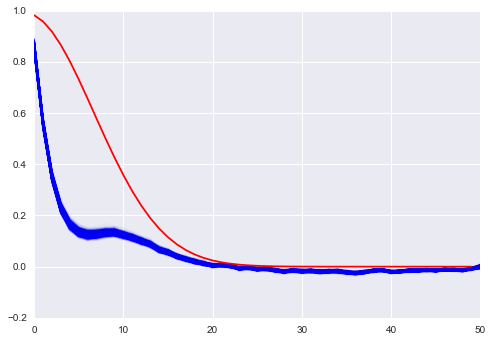

In [254]:
for i in range(0,2000):
    plt.plot(posterior.stan_fit[:,:,-52:-1].reshape(2000,51)[i,:],'b',alpha=0.02,linestyle='-')
plt.plot()
plt.plot(prior250.prf[51:,51],'r')

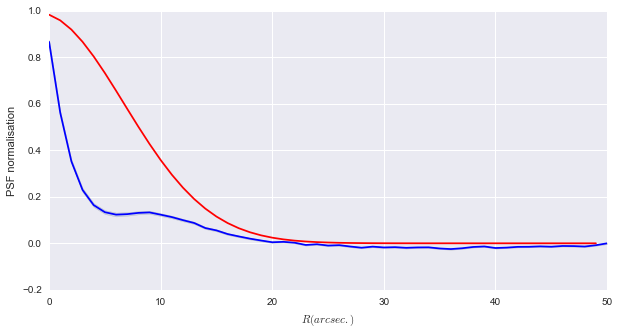

In [255]:
plt.figure(figsize=(10,5))
psf_fit=np.percentile(posterior.stan_fit[:,:,-52:-1].reshape(2000,51),[16.0,50.0,84.0],axis=0)
plt.plot(psf_fit[1,:],'b')
plt.fill_between(np.arange(0,51),psf_fit[0,:],psf_fit[2,:],alpha=0.2)
plt.plot(prior250.prf[51:,51],'r')
plt.xlabel(r'$R (arcsec.)$')
plt.ylabel(r'PSF normalisation')


(array([  1.10000000e+01,   3.00000000e+00,   6.00000000e+00,
          2.00000000e+00,   7.00000000e+00,   4.00000000e+00,
          5.00000000e+00,   1.00000000e+00,   6.00000000e+00,
          4.79200000e+03]),
 array([ 213. ,  258.5,  304. ,  349.5,  395. ,  440.5,  486. ,  531.5,
         577. ,  622.5,  668. ]),
 <a list of 10 Patch objects>)

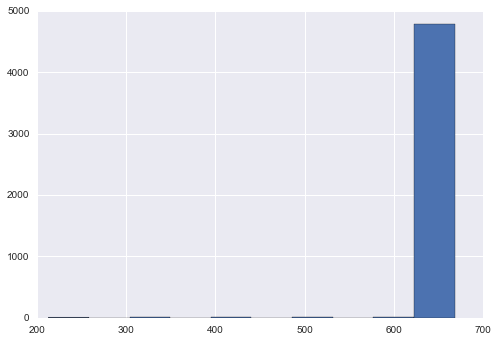

In [257]:
plt.hist(posterior.n_eff)

In [190]:
Sigma=np.empty((51,51))
for i in range(0,51): 
    for j in range(0,51):
        Sigma[i,j] =np.exp(-0.01 * np.power(np.arange(51)[i] - np.arange(51)[j],2))
        if i==j:
            Sigma[i,j]=Sigma[i,j]+0.00001


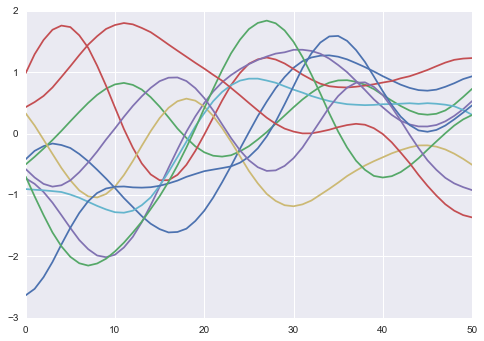

In [191]:
mu=np.zeros(51)

for i in range(0,10):
    plt.plot(np.random.multivariate_normal(mu, Sigma,10)[i])

In [26]:
def ymod_map(prior,flux,PSF):
    from scipy.sparse import coo_matrix

    f=coo_matrix((flux, (range(0,prior.nsrc),np.zeros(prior.nsrc))), shape=(prior.nsrc, 1))
    A=coo_matrix((PSF[prior.amat_data.astype(long)], (prior.amat_row, prior.amat_col)), shape=(prior.snpix, prior.nsrc))
    rmap_temp=(A*f)
    return np.asarray(rmap_temp.todense())

In [240]:
from xidplus import posterior_maps as postmaps

hdulist_250=postmaps.make_fits_image(prior250,prior250.sim)
hdulist_350=postmaps.make_fits_image(prior350,prior350.sim)
hdulist_500=postmaps.make_fits_image(prior500,prior500.sim)


In [241]:
#Set some color info
import seaborn as sns
cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True)
vmin=-1.7E1
vmax=4.446e+01

In [242]:
import warnings
from matplotlib.cbook import MatplotlibDeprecationWarning
warnings.simplefilter('ignore', MatplotlibDeprecationWarning)
warnings.simplefilter('ignore', UserWarning)
warnings.simplefilter('ignore', RuntimeWarning)
warnings.simplefilter('ignore',UnicodeWarning)

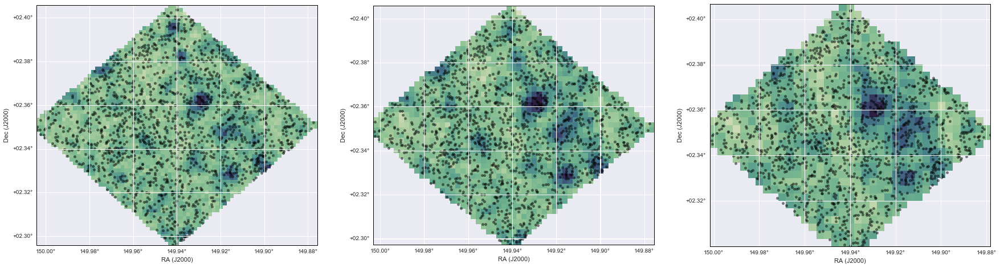

In [243]:
import aplpy
fig = plt.figure(figsize=(30,10))
real_250 = aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,3,1))
real_250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
real_250.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)
real_250.tick_labels.set_xformat('dd.dd')
real_250.tick_labels.set_yformat('dd.dd')

real_350 = aplpy.FITSFigure(hdulist_350[1],figure=fig,subplot=(1,3,2))
real_350.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
real_350.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)
real_350.tick_labels.set_xformat('dd.dd')
real_350.tick_labels.set_yformat('dd.dd')
real_500 = aplpy.FITSFigure(hdulist_500[1],figure=fig,subplot=(1,3,3))
real_500.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
real_500.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)
real_500.tick_labels.set_xformat('dd.dd')
real_500.tick_labels.set_yformat('dd.dd')


In [199]:
mod_map=np.full((hdulist_250[1].data.shape[1],hdulist_250[1].data.shape[0],500),np.nan)
mod_map_array=np.empty((prior250.snpix,500))

for i in range(0,500):
    mod_map_array[:,i]= ymod_map(prior250,posterior.stan_fit[i,0,0:prior250.nsrc],posterior.stan_fit[i,0,-52:-1]).reshape(-1)+posterior.stan_fit[i,0,prior250.nsrc]+np.random.normal(scale=np.sqrt(prior250.snim**2+posterior.stan_fit[i,0,(prior250.nsrc+1)*3]**2))         
    mod_map[prior250.sx_pix-np.min(prior250.sx_pix)-1,prior250.sy_pix-np.min(prior250.sy_pix)-1,i]=mod_map_array[:,i]

In [200]:
mod_map_350=np.full((hdulist_350[1].data.shape[1],hdulist_350[1].data.shape[0],500),np.nan)
mod_map_array_350=np.empty((prior350.snpix,500))

for i in range(0,500):
    mod_map_array_350[:,i]= postmaps.ymod_map(prior350,posterior.stan_fit[i,0,prior350.nsrc+1:2*prior350.nsrc+1]).reshape(-1)+posterior.stan_fit[i,0,2*prior350.nsrc+1]+np.random.normal(scale=np.sqrt(prior350.snim**2+posterior.stan_fit[i,0,1+(prior350.nsrc+1)*3]**2))         
    mod_map_350[prior350.sx_pix-np.min(prior350.sx_pix)-1,prior350.sy_pix-np.min(prior350.sy_pix)-1,i]=mod_map_array_350[:,i]

In [201]:
mod_map_500=np.full((hdulist_500[1].data.shape[1],hdulist_500[1].data.shape[0],500),np.nan)
mod_map_array_500=np.empty((prior500.snpix,500))

for i in range(0,500):
    mod_map_array_500[:,i]= postmaps.ymod_map(prior500,posterior.stan_fit[i,0,2*prior500.nsrc+2:3*prior350.nsrc+2]).reshape(-1)+posterior.stan_fit[i,0,3*prior500.nsrc+2]+np.random.normal(scale=np.sqrt(prior500.snim**2+posterior.stan_fit[i,0,2+(prior500.nsrc+1)*3]**2))         
    mod_map_500[prior500.sx_pix-np.min(prior500.sx_pix)-1,prior500.sy_pix-np.min(prior500.sy_pix)-1,i]=mod_map_array_500[:,i]

In [65]:
import copy
prior250_old=copy.copy(prior250)
prior250_old.get_pointing_matrix()

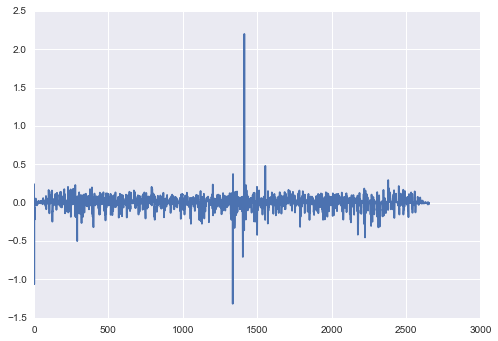

In [70]:
plt.plot(mod_map_array[:,0]/mod_map_array_2[:,0])


In [33]:
from tempfile import NamedTemporaryFile
VIDEO_TAG = """<video controls>
 <source src="data:video/x-m4v;base64,{0}" type="video/mp4">
 Your browser does not support the video tag.
</video>"""

def anim_to_html(anim):
    if not hasattr(anim, '_encoded_video'):
        with NamedTemporaryFile(suffix='.mp4') as f:
            anim.save(f.name, fps=20, extra_args=['-vcodec', 'libx264'])
            video = open(f.name, "rb").read()
        anim._encoded_video = video.encode("base64")
    
    return VIDEO_TAG.format(anim._encoded_video)
from matplotlib import animation
from IPython.display import HTML


def display_animation(anim):
    plt.close(anim._fig)
    return HTML(anim_to_html(anim))

In [34]:

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(30,10))
res250=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,3,1))
res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res250.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)

res350=aplpy.FITSFigure(hdulist_350[1],figure=fig,subplot=(1,3,2))
res350.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res350.show_markers(prior350.sra, prior350.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)

res500=aplpy.FITSFigure(hdulist_500[1],figure=fig,subplot=(1,3,3))
res500.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res500.show_markers(prior500.sra, prior500.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)

# animation function.  This is called sequentially
def animate(i):
    res250._data=mod_map[:,:,i].T
    res350._data=mod_map_350[:,:,i].T
    res500._data=mod_map_500[:,:,i].T

    res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
    res350.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
    res500.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)


    return [res250,res350,res500]
# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate,
                               frames=500, interval=1000)

anim.save('post_animation.mp4', fps=20, extra_args=['-vcodec', 'libx264'])

# call our new function to display the animation
display_animation(anim)

In [37]:
import scipy.stats as st

pval_250=np.empty_like(prior250.sim)
for i in range(0,prior250.snpix):
    ind=mod_map_array[i,:]<prior250.sim[i]
    pval_250[i]=st.norm.ppf(sum(ind)/np.float(mod_map_array.shape[1]))
pval_250[np.isposinf(pval_250)]=6

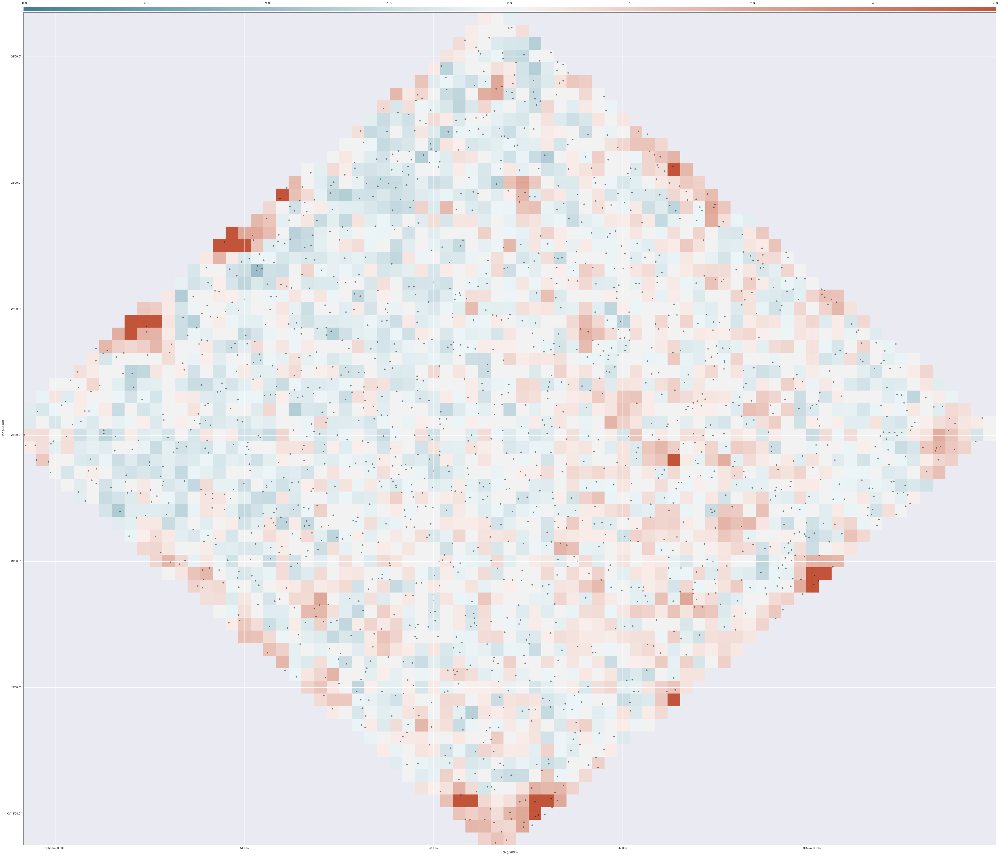

In [38]:
vmin=-6
vmax=6
cmap=sns.diverging_palette(220, 20,as_cmap=True)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(60,60))
res250=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,1,1))
res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res250.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)
res250._data[prior250.sy_pix-np.min(prior250.sy_pix)-1,prior250.sx_pix-np.min(prior250.sx_pix)-1]=pval_250

res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)

res250.add_colorbar()
res250.colorbar.set_location('top')



In [7]:
moc_routines.get_HEALPix_pixels(10,149.95745,02.33254)

array([6978147])

(580, 600)

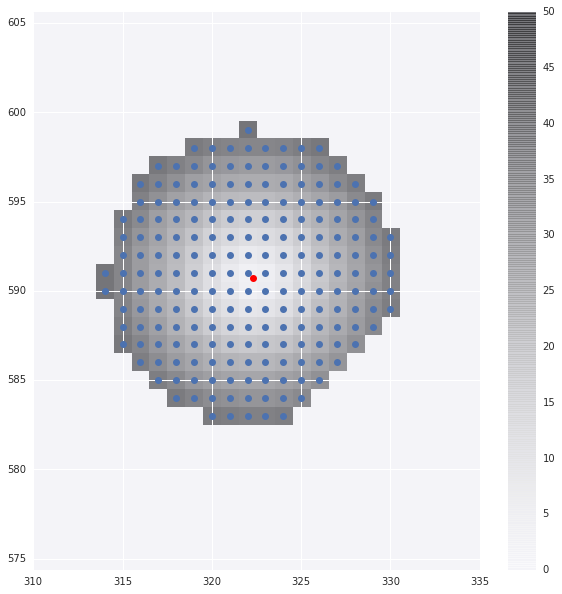

In [82]:
plt.figure(figsize=(10,10))

i=140
ind=prior250.amat_col == i
test=np.zeros((np.max(prior250.sx_pix),np.max(prior250.sy_pix)))
test[prior250.sx_pix[prior250.amat_row[ind]],prior250.sy_pix[prior250.amat_row[ind]]]=prior250.amat_data[ind]
#plt.plot(prior250.amat_row[prior250.amat_col == 200],prior250.amat_data[prior250.amat_col == 200])
plt.plot(prior250.sx_pix[prior250.amat_row[prior250.amat_col == i]],prior250.sy_pix[prior250.amat_row[prior250.amat_col == i]],'o')
plt.plot(prior250.sx[i],prior250.sy[i],'ro')
plt.axes().set_aspect('equal', 'datalim')
plt.imshow(test.T,alpha=0.5, interpolation='nearest')
plt.colorbar()
plt.xlim(310,335)
plt.ylim(580,600)

In [42]:
from scipy import interpolate
paxis1, paxis2 = prior250.prf.shape
f = interpolate.interp1d(prior250.pindx[0:(paxis1 + 1.) / 2],np.arange((paxis1 + 1.) / 2.),kind='nearest')


In [46]:
print f(1.0)

6.0


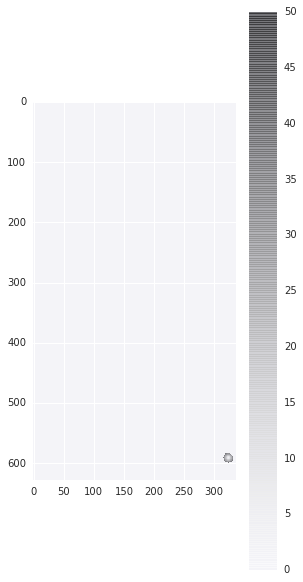

In [78]:
plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.imshow(test.T,alpha=0.5, interpolation='nearest')
plt.colorbar()


In [71]:
fit=SPIRE.all_bands(prior250_old,prior350,prior500,iter=1000)

/Users/pdh21/HELP/XID_plus/notebooks/XID+SPIRE.pkl not found. Compiling


In [72]:
posterior_old=xidplus.posterior_stan(fit,[prior250_old,prior350,prior500])


(array([ 199.,  194.,  220.,  217.,  215.,  204.,  199.,  200.,  180.,  172.]),
 array([  4.74197403e-02,   5.22175264e+00,   1.03960855e+01,
          1.55704184e+01,   2.07447513e+01,   2.59190842e+01,
          3.10934171e+01,   3.62677500e+01,   4.14420829e+01,
          4.66164158e+01,   5.17907487e+01]),
 <a list of 10 Patch objects>)

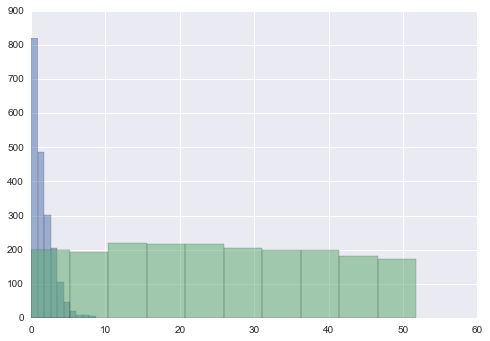

In [91]:
plt.hist(posterior_old.stan_fit[:,:,301].reshape(-1),alpha=0.5)
plt.hist(posterior.stan_fit[:,:,301].reshape(-1),alpha=0.5)

In [93]:
print posterior_old.Rhat[300],posterior.Rhat[300]

0.999858835182 0.998514289616


(array([   9.,   30.,  120.,  326.,  529.,  539.,  292.,  125.,   24.,    6.]),
 array([-25556.41286051, -25515.04751729, -25473.68217406, -25432.31683083,
        -25390.95148761, -25349.58614438, -25308.22080116, -25266.85545793,
        -25225.4901147 , -25184.12477148, -25142.75942825]),
 <a list of 10 Patch objects>)

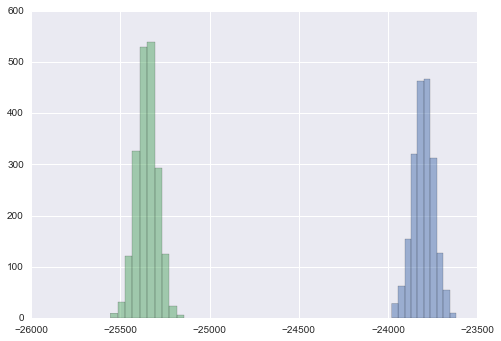

In [97]:
plt.hist(posterior.stan_fit[:,:,-1].reshape(-1),alpha=0.5)
plt.hist(posterior_old.stan_fit[:,:,-1].reshape(-1),alpha=0.5)

(array([   2.,   38.,   92.,  257.,  412.,  487.,  385.,  225.,   81.,   21.]),
 array([-20.52763826, -20.20484959, -19.88206092, -19.55927225,
        -19.23648358, -18.91369492, -18.59090625, -18.26811758,
        -17.94532891, -17.62254024, -17.29975158]),
 <a list of 10 Patch objects>)

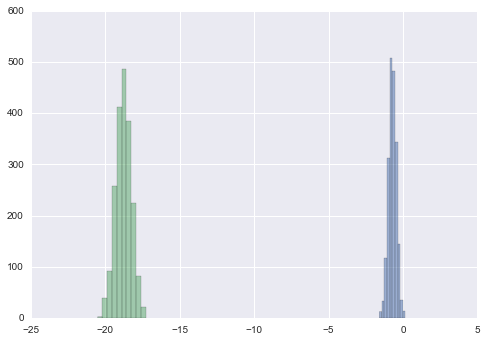

In [100]:
plt.hist(posterior.stan_fit[:,:,prior250.nsrc].reshape(-1),alpha=0.5)
plt.hist(prior250_old.bkg[1]*posterior_old.stan_fit[:,:,prior250.nsrc].reshape(-1)+prior250_old.bkg[0],alpha=0.5)


(array([   8.,   19.,   95.,  230.,  445.,  532.,  419.,  184.,   55.,   13.]),
 array([ 2.41475739,  2.50610448,  2.59745158,  2.68879868,  2.78014577,
         2.87149287,  2.96283997,  3.05418706,  3.14553416,  3.23688126,
         3.32822835]),
 <a list of 10 Patch objects>)

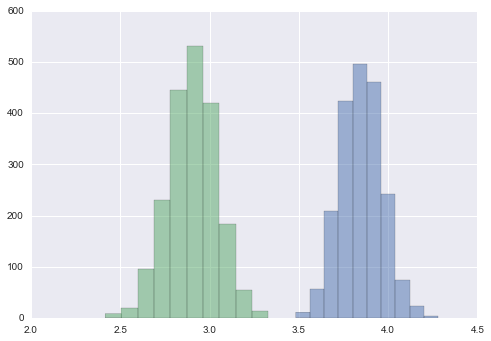

In [112]:
plt.hist(posterior.stan_fit[:,:,-55].reshape(-1),alpha=0.5)
plt.hist(posterior_old.stan_fit[:,:,-4].reshape(-1),alpha=0.5)

In [114]:
mod_map_2=np.full((hdulist_250[1].data.shape[1],hdulist_250[1].data.shape[0],500),np.nan)
mod_map_array_2=np.empty((prior250.snpix,500))

for i in range(0,500):
    mod_map_array_2[:,i]= postmaps.ymod_map(prior250_old,posterior_old.stan_fit[i,0,0:prior250.nsrc]).reshape(-1)+prior250_old.bkg[1]*posterior_old.stan_fit[i,0,prior250.nsrc]+prior250_old.bkg[0]+np.random.normal(scale=np.sqrt(prior250.snim**2+posterior.stan_fit[i,0,(prior250.nsrc+1)*3]**2))         
    mod_map_2[prior250.sx_pix-np.min(prior250.sx_pix)-1,prior250.sy_pix-np.min(prior250.sy_pix)-1,i]=mod_map_array_2[:,i]

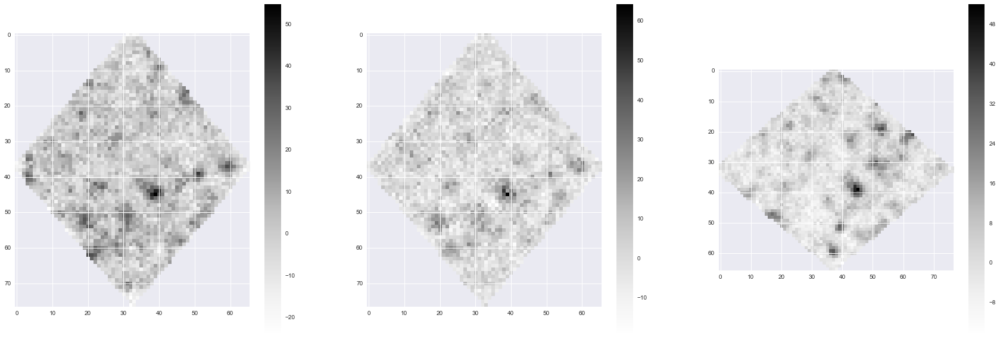

In [120]:
fig = plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(mod_map_2[:,:,0], interpolation='nearest')
plt.colorbar()
plt.subplot(1,3,2)
plt.imshow(mod_map[:,:,0], interpolation='nearest')
plt.colorbar()
plt.subplot(1,3,3)
plt.imshow(hdulist_250[1].data, interpolation='nearest')
plt.colorbar()


In [123]:

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(30,10))
res250=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,3,1))
res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res250.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)

res350=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,3,2))
res350.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res350.show_markers(prior350.sra, prior350.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)

res500=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,3,3))
res500.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res500.show_markers(prior500.sra, prior500.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)

# animation function.  This is called sequentially
def animate(i):
    res250._data=mod_map[:,:,i].T
    res350._data=mod_map_2[:,:,i].T

    res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
    res350.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
    res500.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)


    return [res250,res350,res500]
# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate,
                               frames=500, interval=1000)

anim.save('post_animation.mp4', fps=20, extra_args=['-vcodec', 'libx264'])

# call our new function to display the animation
display_animation(anim)

In [137]:
import scipy.stats as st

pval_250_2=np.empty_like(prior250.sim)
for i in range(0,prior250.snpix):
    ind=mod_map_array_2[i,:]<prior250.sim[i]
    pval_250_2[i]=st.norm.ppf(sum(ind)/np.float(mod_map_array_2.shape[1]))
pval_250_2[np.isposinf(pval_250_2)]=6
pval_250_2[np.isneginf(pval_250_2)]=-6

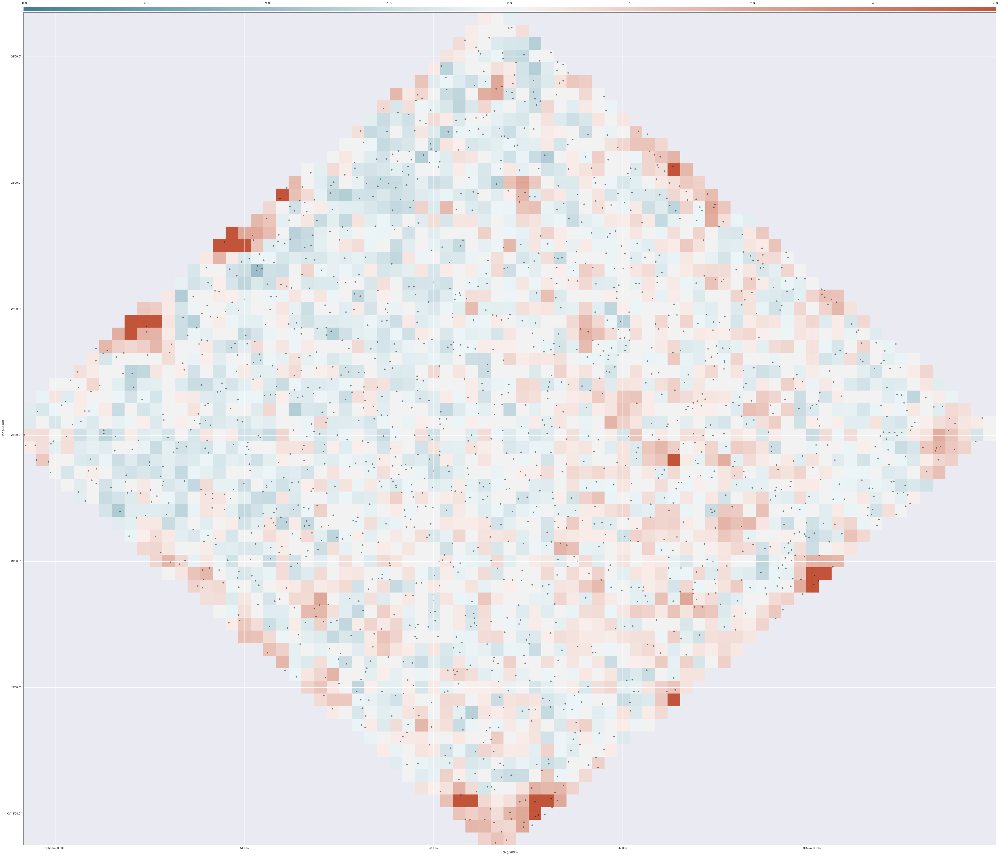

In [138]:
vmin=-6
vmax=6
cmap=sns.diverging_palette(220, 20,as_cmap=True)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(60,60))
res250=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,1,1))
res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res250.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)
res250._data[prior250.sy_pix-np.min(prior250.sy_pix)-1,prior250.sx_pix-np.min(prior250.sx_pix)-1]=pval_250

res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)

res250.add_colorbar()
res250.colorbar.set_location('top')


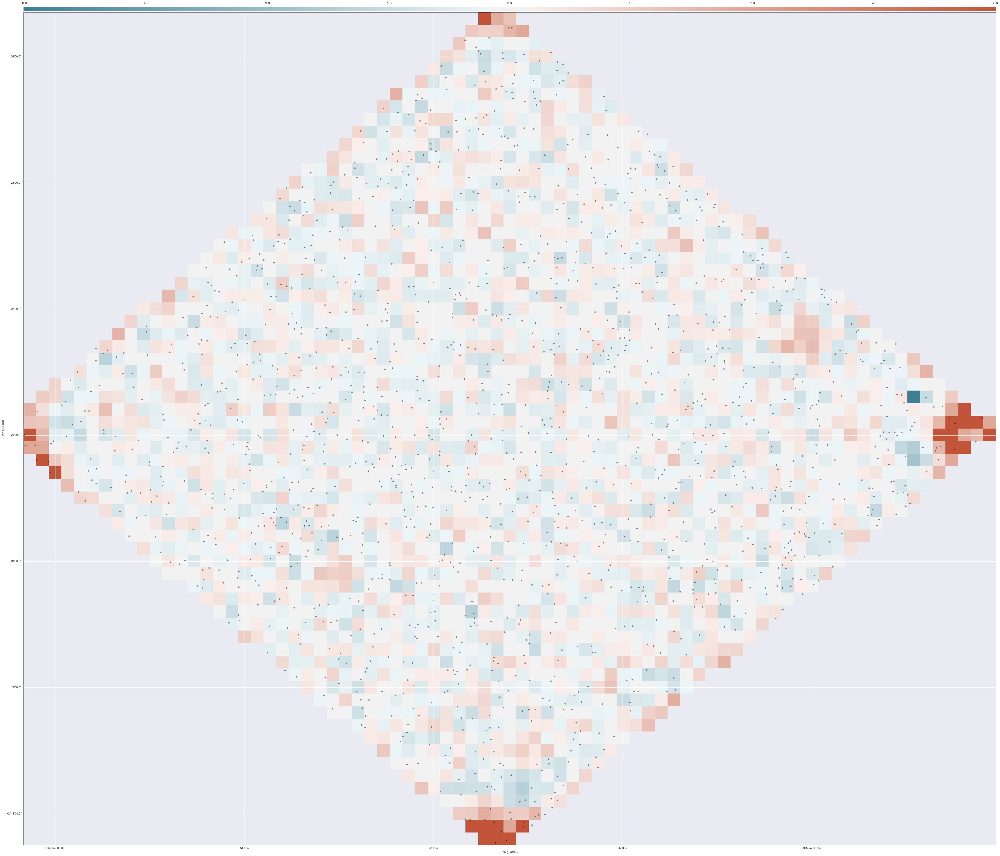

In [139]:
vmin=-6
vmax=6
cmap=sns.diverging_palette(220, 20,as_cmap=True)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(60,60))
res250=aplpy.FITSFigure(hdulist_250[1],figure=fig,subplot=(1,1,1))
res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)
res250.show_markers(prior250.sra, prior250.sdec, edgecolor='black', facecolor='black',
                marker='o', s=20, alpha=0.5)
res250._data[prior250.sy_pix-np.min(prior250.sy_pix)-1,prior250.sx_pix-np.min(prior250.sx_pix)-1]=pval_250_2

res250.show_colorscale(vmin=vmin,vmax=vmax,cmap=cmap)

res250.add_colorbar()
res250.colorbar.set_location('top')


(array([   1.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    1.,    0.,    0.,
           0.,    0.,    1.,    2.,    1.,    3.,    1.,    6.,    5.,
          18.,   17.,   31.,   33.,   33.,   51.,   60.,   96.,  113.,
         136.,  143.,  180.,  163.,  168.,  178.,  170.,  167.,  127.,
         141.,  109.,   97.,   73.,   71.,   58.,   25.,   21.,   19.,
          21.,   18.,   10.,   11.,   11.,    7.,    3.,    5.,    2.,
           1.,    3.,    6.,    3.,    2.,    3.,    0.,    8.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.]),
 array([ -6.00000000e+00,  -5.90000000e+00,  -5.80000

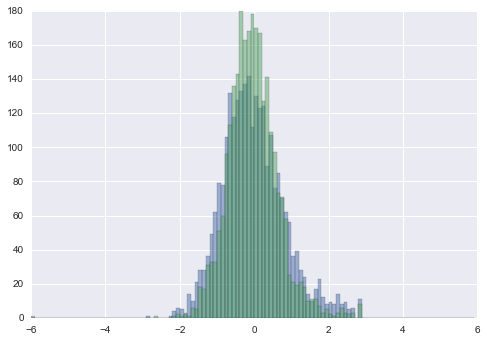

In [142]:
plt.hist(pval_250,alpha=0.5,bins=np.arange(-6,6,0.1))
plt.hist(pval_250_2,alpha=0.5,bins=np.arange(-6,6,0.1))


In [168]:
mean_post=np.percentile(posterior.stan_fit[:,:,0:prior250.nsrc].reshape(500*4,prior250.nsrc),[16,50,84],axis=0)
mean_post_old=np.percentile(posterior_old.stan_fit[:,:,0:prior250.nsrc].reshape(500*4,prior250.nsrc),[16,50,84],axis=0)


(0, 40)

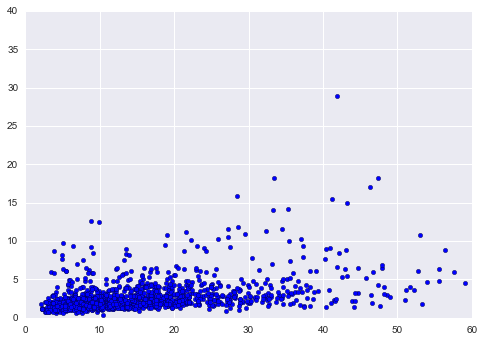

In [176]:
plt.scatter(mean_post[1,:],mean_post_old[1,:])
plt.xlim(0,60)
plt.ylim(0,40)

In [179]:
np.sqrt(6**2+12**2)

13.416407864998739

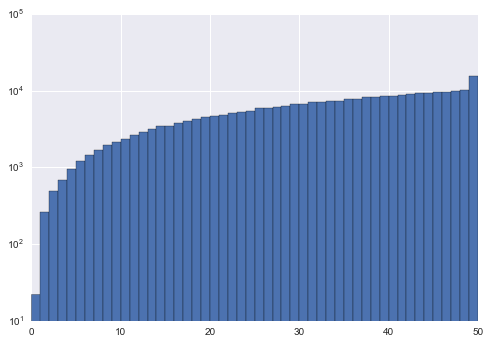

In [184]:
plt.hist(prior250.amat_data,np.arange(0,51))
plt.yscale('log')

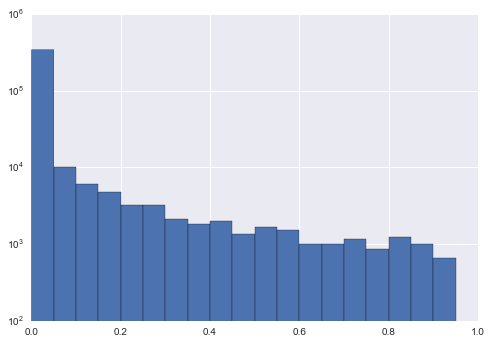

In [187]:
plt.hist(prior250_old.amat_data,np.arange(0.0,1.0,0.05))
plt.yscale('log')

In [205]:
from scipy import fftpack
import radialProfile


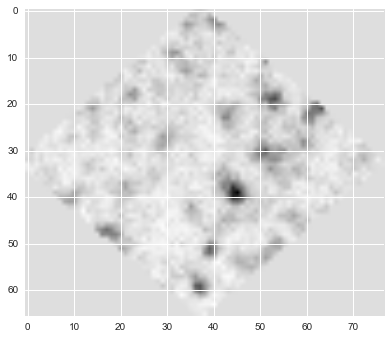

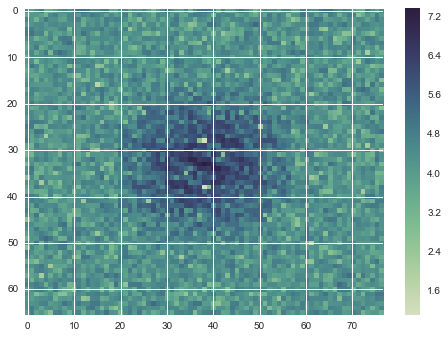

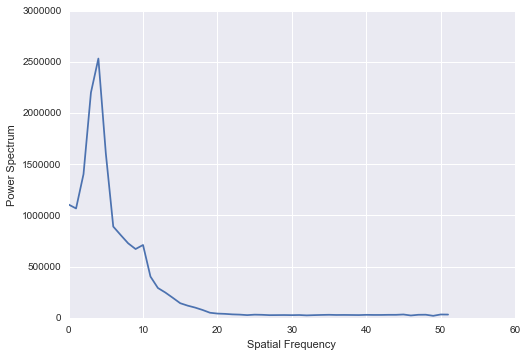

In [246]:
image=hdulist_250[1].data
image[np.isnan(image)]=0.0
# Take the fourier transform of the image.
F1 = fftpack.fft2(image)
 
# Now shift the quadrants around so that low spatial frequencies are in
# the center of the 2D fourier transformed image.
F2 = fftpack.fftshift( F1 )
 
# Calculate a 2D power spectrum
psd2D = np.abs( F2 )**2
 
# Calculate the azimuthally averaged 1D power spectrum
psd1D = radialProfile.azimuthalAverage(psd2D)
 
# Now plot up both
plt.figure(1)
plt.clf()
plt.imshow(image , cmap=plt.cm.Greys)
 
plt.figure(2)
plt.clf()
plt.imshow(np.log10(psd2D), interpolation='nearest',cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True))
plt.colorbar()
 
plt.figure(3)
plt.clf()
plt.plot( psd1D )
plt.xlabel('Spatial Frequency')
plt.ylabel('Power Spectrum')

In [218]:
print psd2D

[[  41772.20147711   25377.99647938   91422.60583832 ...,  118287.6959821
   133552.44082452    4462.56332055]
 [  42091.33542215   54609.8366909    53194.22787956 ...,   28174.73807478
   140339.25482884   72078.96763798]
 [  30991.61219171   46980.4691455     9275.44367586 ...,   32318.66062229
    52865.32995852   56099.01647749]
 ..., 
 [  30991.61219171   56099.01647749   52865.32995852 ...,   23568.79346976
     9275.44367586   46980.4691455 ]
 [  42091.33542215   72078.96763798  140339.25482884 ...,   41785.11827048
    53194.22787956   54609.8366909 ]
 [  41772.20147711    4462.56332055  133552.44082452 ...,   32692.94982913
    91422.60583832   25377.99647938]]


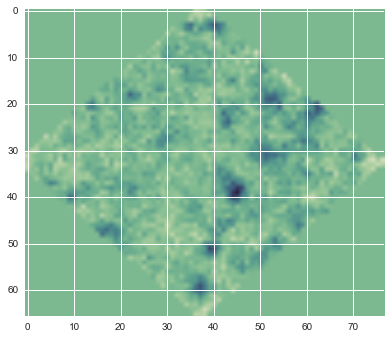

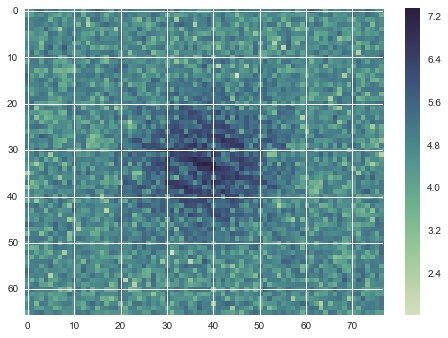

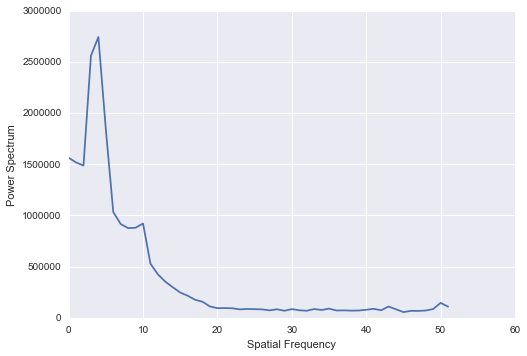

In [258]:
image=mod_map_2[:,:,0].T
image[np.isnan(image)]=0.0
# Take the fourier transform of the image.
F1 = fftpack.fft2(image)
 
# Now shift the quadrants around so that low spatial frequencies are in
# the center of the 2D fourier transformed image.
F2 = fftpack.fftshift( F1 )
 
# Calculate a 2D power spectrum
psd2D = np.abs( F2 )**2
 
# Calculate the azimuthally averaged 1D power spectrum
psd1D = radialProfile.azimuthalAverage(psd2D)
 
# Now plot up both
plt.figure(1)
plt.clf()
plt.imshow(image , cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True))
 
plt.figure(2)
plt.clf()
plt.imshow(np.log10(psd2D), interpolation='nearest',cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True))
plt.colorbar()
 
plt.figure(3)
plt.clf()
plt.plot( psd1D )
plt.xlabel('Spatial Frequency')
plt.ylabel('Power Spectrum')

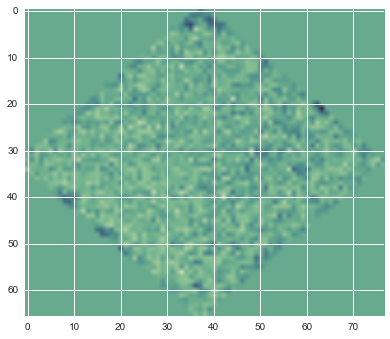

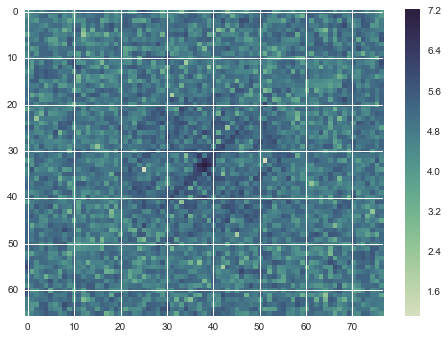

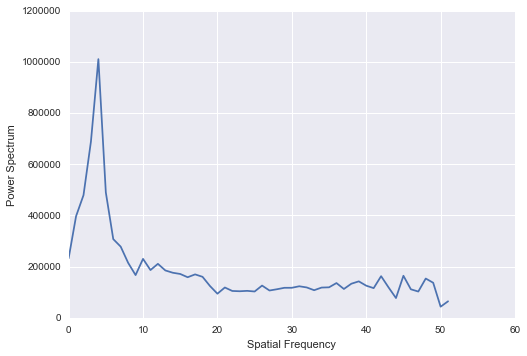

In [251]:
image=hdulist_250[1].data-mod_map[:,:,0].T
image[np.isnan(image)]=0.0
# Take the fourier transform of the image.
F1 = fftpack.fft2(image)
 
# Now shift the quadrants around so that low spatial frequencies are in
# the center of the 2D fourier transformed image.
F2 = fftpack.fftshift( F1 )
 
# Calculate a 2D power spectrum
psd2D = np.abs( F2 )**2
 
# Calculate the azimuthally averaged 1D power spectrum
psd1D = radialProfile.azimuthalAverage(psd2D)
 
# Now plot up both
plt.figure(1)
plt.clf()
plt.imshow(image , cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True))
 
plt.figure(2)
plt.clf()
plt.imshow(np.log10(psd2D), interpolation='nearest',cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True))
plt.colorbar()
 
plt.figure(3)
plt.clf()
plt.plot( psd1D )
plt.xlabel('Spatial Frequency')
plt.ylabel('Power Spectrum')

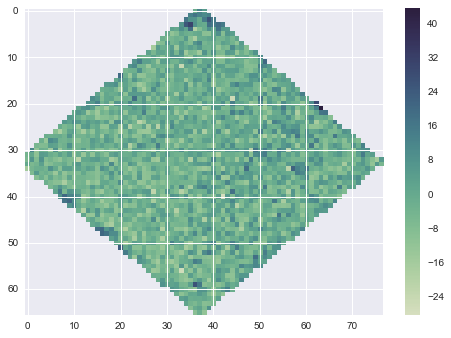

In [245]:
plt.imshow(hdulist_250[1].data-mod_map[:,:,0].T, interpolation='nearest',cmap=sns.cubehelix_palette(8, start=.5, rot=-.75,as_cmap=True))

plt.colorbar()